### Rhabdom Viewer
View the alligned rhabdom stack of a particular ommatidium. Each slice is shown in a different cell. 

In [1]:
import os
import matplotlib.pyplot as plt
import numpy as np

In [33]:
save_figs = False

In [30]:
om = 'A3'
# crop xy of the stack
h_range = range(150: 1300) # use slice(None) for uncropped
v_range = range(150: 1300)
#vol_path = "~/Data/200812_rhab/omC6_axon_to_lens_im_rotated_crop.npz"
vol_path = f"/mnt/ceph/data/neuro/wasp_em/nchua/200817_rhab_xsections/om{om}_axon_to_lens_im_rotated_crop.npz"
#vol_path = f"/mnt/ceph/data/neuro/wasp_em/nchua/200817_A4copy/om{om}_axon_to_lens_im_rotated_crop.npz"
with np.load(os.path.expanduser(vol_path)) as data:
    #vol = data['im_crop'][100:1500, 100:1500] 
    vol = data['im_crop'][h_range, v_range] 
    # normally: 400:1200

## Longtitudinal profile

In [35]:
# longtitudinal profile
fig, ax = plt.subplots(1, figsize=[10, 30])

l_slice = np.flip(vol[:, 580, :], axis=1)
l_slice = np.flip(l_slice, axis=0)
ax = plt.imshow(l_slice, cmap='gray', aspect='equal')

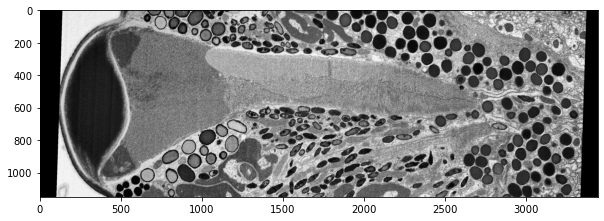

In [35]:
if save_figs:
    fig.savefig('/mnt/home/nchua/Dropbox/lamina_figures/A3_long_em.svg')
    plt.imsave('/mnt/home/nchua/Dropbox/lamina_figures/A3_long_em.png', l_slice, cmap='gray', 
               dpi=800)
    

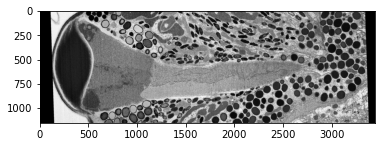

In [37]:
# longtitudinal profile
fig, ax = plt.subplots(1)
l_slice = np.flip(vol[:, 550, :], axis=1)
ax = plt.imshow(l_slice, cmap='gray')

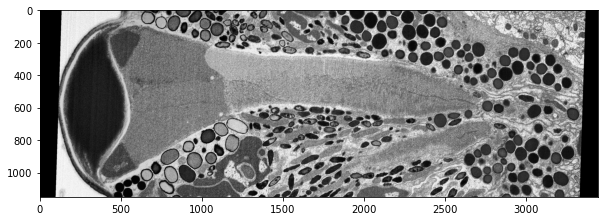

In [36]:
fig, ax = plt.subplots(1, figsize=[10, 30])

l_slice = np.flip(vol[:, 600, :], axis=1)
l_slice = np.flip(l_slice, axis=0)
ax = plt.imshow(l_slice, cmap='gray', aspect='equal')

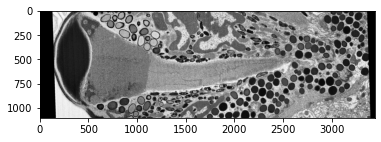

In [19]:
# longtitudinal profile
fig, ax = plt.subplots(1)
l_slice = np.flip(vol[:, 430, :], axis=1)
ax = plt.imshow(l_slice, cmap='gray')

In [12]:
step = 25
start = 2200

Subtype designation/landmarks:
- R7 tends to be present in the most distal slices (it emerges slightly earlier than R7'), but leaves the rhabdom early in non-DRA ommatidia. 
- R7 often appears paler than the rest (anastasia's observation)
- In non-DRA: R7 is replaced by R8 ~ the beginning of the proximal half, In DRA: R1 is replaced by R8 (digestDATA.pdf)
- R7 is between R1 and R6 before it leaves the rhabdom, **R7 and R6** are co-oriented, so they frequently appear connected 
- R7' is between R3 and R4, **R7' and R4** have co-oriented microvilli, so they frequently appear connected 
- Other co-oriented neighbors that are hard to delineate: **(R5, R6)**, **(R2, R3)** 


- In a more intermediary slice in the distal half:
    - Look for two  opposing rhabdomeres with co-oriented microvilli (thin arms) that reach towards the center of the rhabdom and join. This will be R1 and R4. Both R1's neighbors have orthogonal microvilli, but R4 has one co-oriented neighbor (R7') and one orthogonal neighbor (R5). R7' looks more like a wedge than R4. R4 and R7' tend to appear at the same very distal depth
    - If R7'->R4 (CW), R1-6 numbers increase clockwise. If R4->R7' (CW), R1-6 numbers decrease clockwise. 
    
    - R7'->R4 (CW): R1->(R2->R3)->(R7'->R4)->(R5->R6->R7)->R1 (CW)
    - R4->R7' (CW): R1->(R7->R6->R5)->(R4->R7')->(R3->R2)->R1 (CW)
    - (CO-ORIENTED -> NEIGHBORS)
    

## C6
- Starts distally ~ z'= 2300
- Ends proximally ~ z'= 800  
- R7'->R4 (CW)
- R7 looks lighter, generally confident with my assignment
- I cannot see the large ~78 degrees twist for R7 that was reported between the 6th and 7th measurements: I see a total change of ~10 degrees

## A4
- A4 starts distally ~ z'= 2250
- A4 ends proximally ~ z'= 800
- 

## B1
- Starts distally ~ z' = 3100

- R7'->R4 (CW)


In [13]:
# Visual guides for angles
guides = False
def add_crosshairs(ax):
    ax = plt.plot([0, vol.shape[0]], [0, vol.shape[0]], c='k', ls='--')
    ax = plt.plot([0, vol.shape[0]], [vol.shape[0], 0], c='k', ls='--')
    ax = plt.plot([vol.shape[0]/2, vol.shape[0]/2], [0, vol.shape[1]], c='k', ls='--')
    ax = plt.plot([0, vol.shape[1]], [vol.shape[0]/2, vol.shape[0]/2], c='k', ls='--')
    return ax

Text(0.5, 0.98, "om: A3, Depth: 2200, R7 = x, R7'= +")

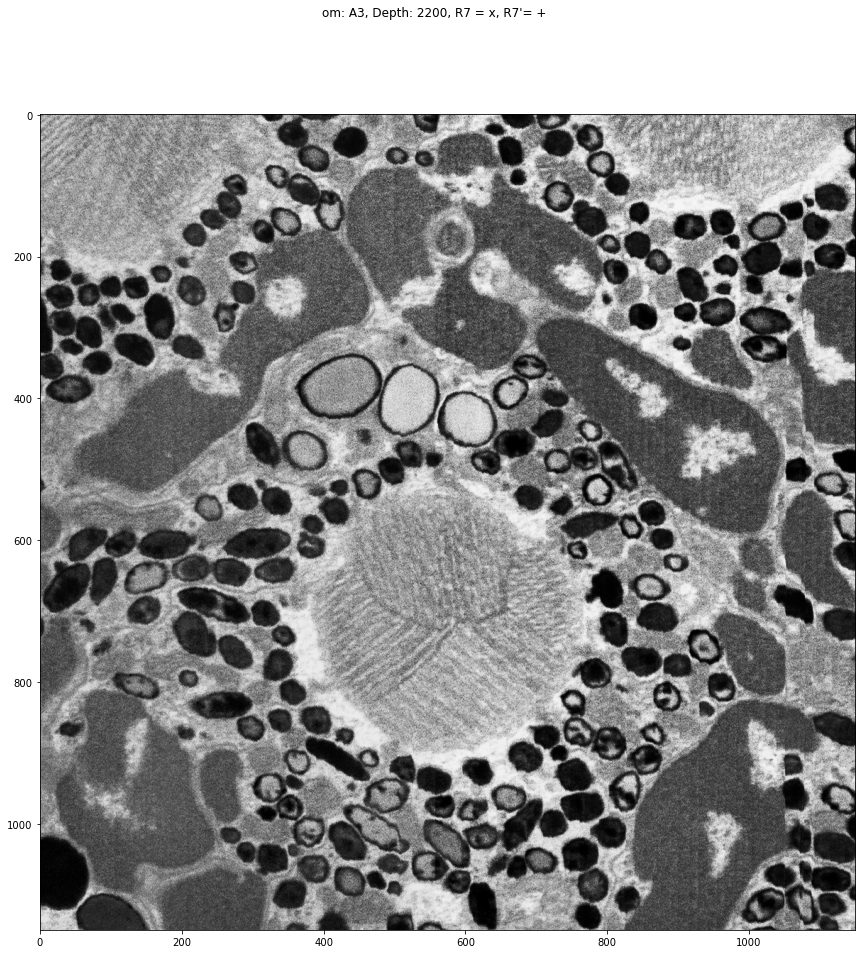

In [27]:
fig, ax = plt.subplots(1, figsize=[15, 15])
d = start

if om == 'C6':
    ax = plt.scatter(400, 550, s=200, marker='x', c='r')
    ax = plt.scatter(355, 385, s=200, marker='+', c='r')
elif om == 'A4':
    ax = plt.scatter(500, 500, s=200, marker='x', c='r')
    ax = plt.scatter(300, 300, s=200, marker='+', c='r')
elif om == 'B1':
    ax = plt.scatter(600, 300, s=200, marker='x', c='r')
    ax = plt.scatter(275, 300, s=200, marker='+', c='r')

if guides:
    ax = add_crosshairs(ax)

ax = plt.imshow(vol[:, :, d], cmap='gray', aspect='equal')

fig.suptitle(f"om: {om}, Depth: {d}, R7 = x, R7'= +")

In [64]:
plt.imsave('/mnt/home/nchua/Dropbox/A3rh_z2175.png', vol[:, :, d], cmap='gray')

In [ ]:
fig, ax = plt.subplots(1, figsize=[15, 15])
d = d-step

if guides:
    ax = cross_hairs()

ax = plt.imshow(vol[:, :, d], cmap='gray', aspect='equal')

fig.suptitle(f"om: {om}, Depth: {d}vx")

Text(0.5,0.98,'om: A3, Depth: 2150vx')

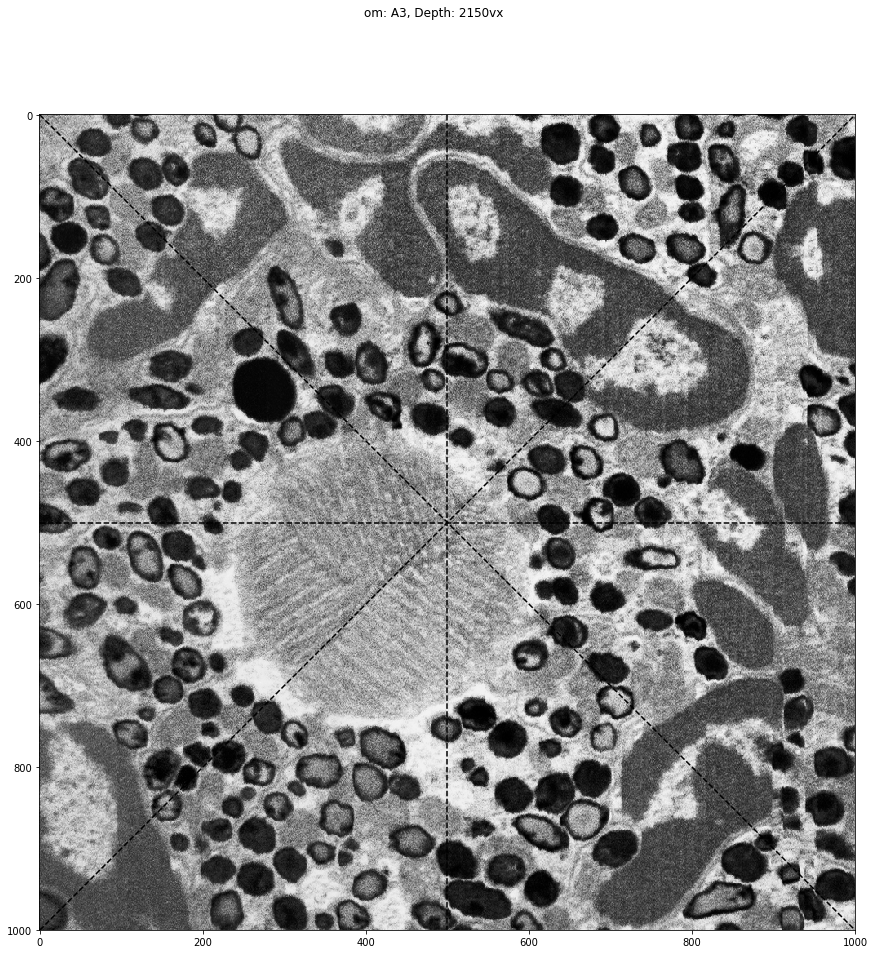

In [33]:
fig, ax = plt.subplots(1, figsize=[15, 15])
d = d-step

ax = plt.plot([0, vol.shape[0]], [0, vol.shape[0]], c='k', ls='--')
ax = plt.plot([0, vol.shape[0]], [vol.shape[0], 0], c='k', ls='--')
ax = plt.plot([vol.shape[0]/2, vol.shape[0]/2], [0, vol.shape[1]], c='k', ls='--')
ax = plt.plot([0, vol.shape[1]], [vol.shape[0]/2, vol.shape[0]/2], c='k', ls='--')

ax = plt.imshow(vol[:, :, d], cmap='gray', aspect='equal')

fig.suptitle(f"om: {om}, Depth: {d}vx")

Text(0.5,0.98,'om: A3, Depth: 2125vx')

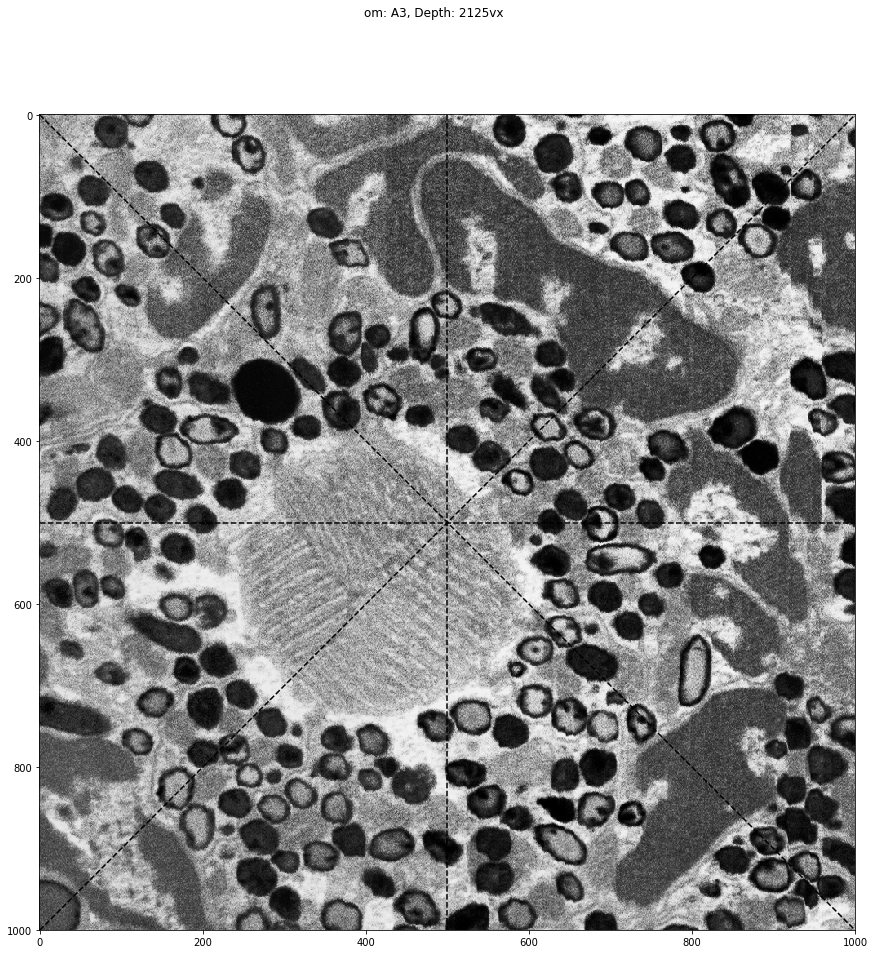

In [34]:
fig, ax = plt.subplots(1, figsize=[15, 15])
d = d-step

ax = plt.plot([0, vol.shape[0]], [0, vol.shape[0]], c='k', ls='--')
ax = plt.plot([0, vol.shape[0]], [vol.shape[0], 0], c='k', ls='--')
ax = plt.plot([vol.shape[0]/2, vol.shape[0]/2], [0, vol.shape[1]], c='k', ls='--')
ax = plt.plot([0, vol.shape[1]], [vol.shape[0]/2, vol.shape[0]/2], c='k', ls='--')

ax = plt.imshow(vol[:, :, d], cmap='gray', aspect='equal')

fig.suptitle(f"om: {om}, Depth: {d}vx")

Text(0.5,0.98,'om: A3, Depth: 2000vx')

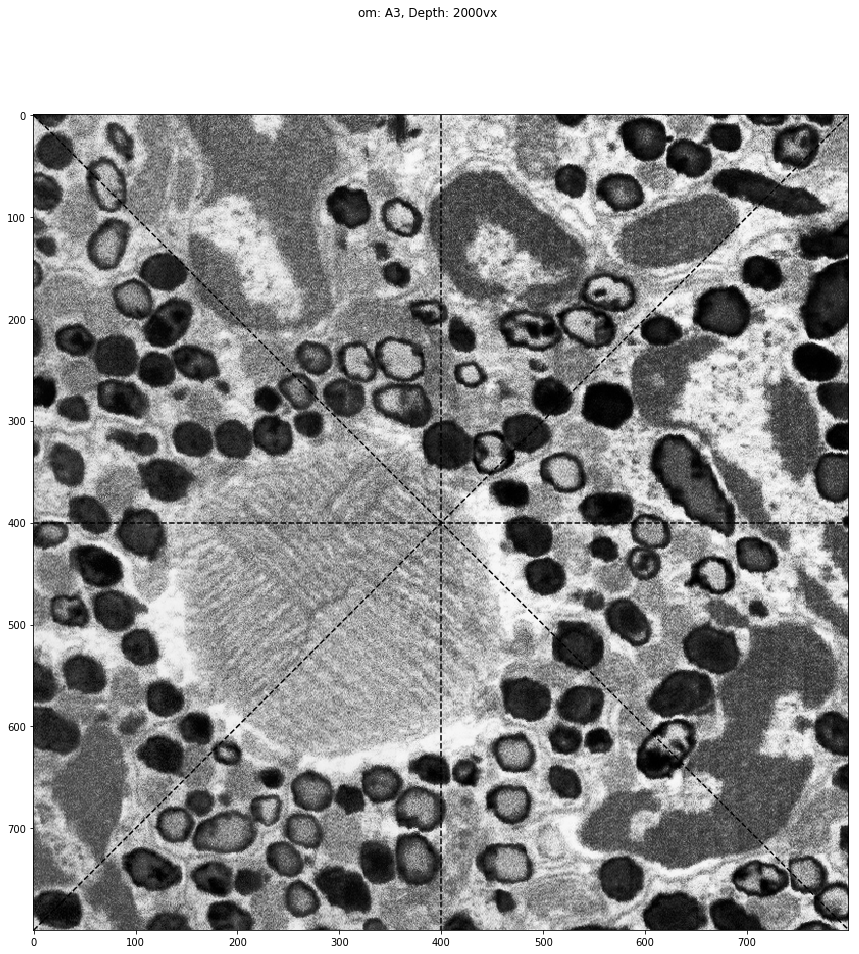

In [13]:
fig, ax = plt.subplots(1, figsize=[15, 15])
d = d-step

ax = plt.plot([0, vol.shape[0]], [0, vol.shape[0]], c='k', ls='--')
ax = plt.plot([0, vol.shape[0]], [vol.shape[0], 0], c='k', ls='--')
ax = plt.plot([vol.shape[0]/2, vol.shape[0]/2], [0, vol.shape[1]], c='k', ls='--')
ax = plt.plot([0, vol.shape[1]], [vol.shape[0]/2, vol.shape[0]/2], c='k', ls='--')

ax = plt.imshow(vol[:, :, d], cmap='gray', aspect='equal')

fig.suptitle(f"om: {om}, Depth: {d}vx")

Text(0.5,0.98,'om: A3, Depth: 1950vx')

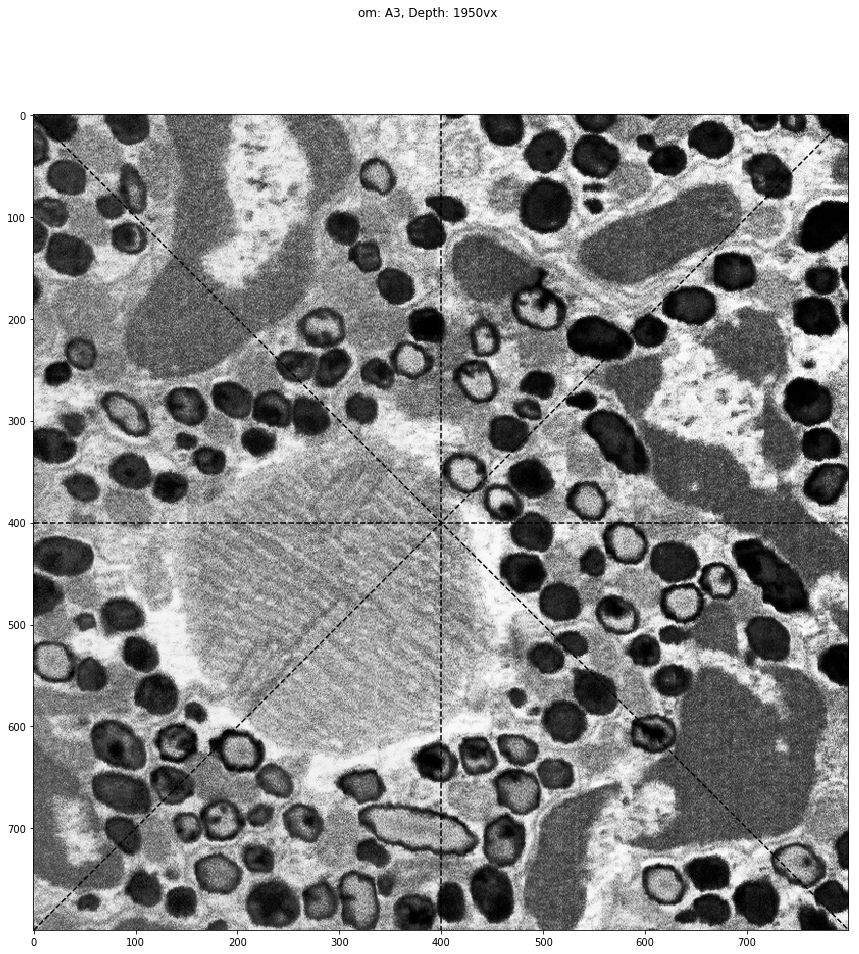

In [14]:
fig, ax = plt.subplots(1, figsize=[15, 15])
d = d-step

ax = plt.plot([0, vol.shape[0]], [0, vol.shape[0]], c='k', ls='--')
ax = plt.plot([0, vol.shape[0]], [vol.shape[0], 0], c='k', ls='--')
ax = plt.plot([vol.shape[0]/2, vol.shape[0]/2], [0, vol.shape[1]], c='k', ls='--')
ax = plt.plot([0, vol.shape[1]], [vol.shape[0]/2, vol.shape[0]/2], c='k', ls='--')

ax = plt.imshow(vol[:, :, d], cmap='gray', aspect='equal')

fig.suptitle(f"om: {om}, Depth: {d}vx")

Text(0.5,0.98,'om: A3, Depth: 1900vx')

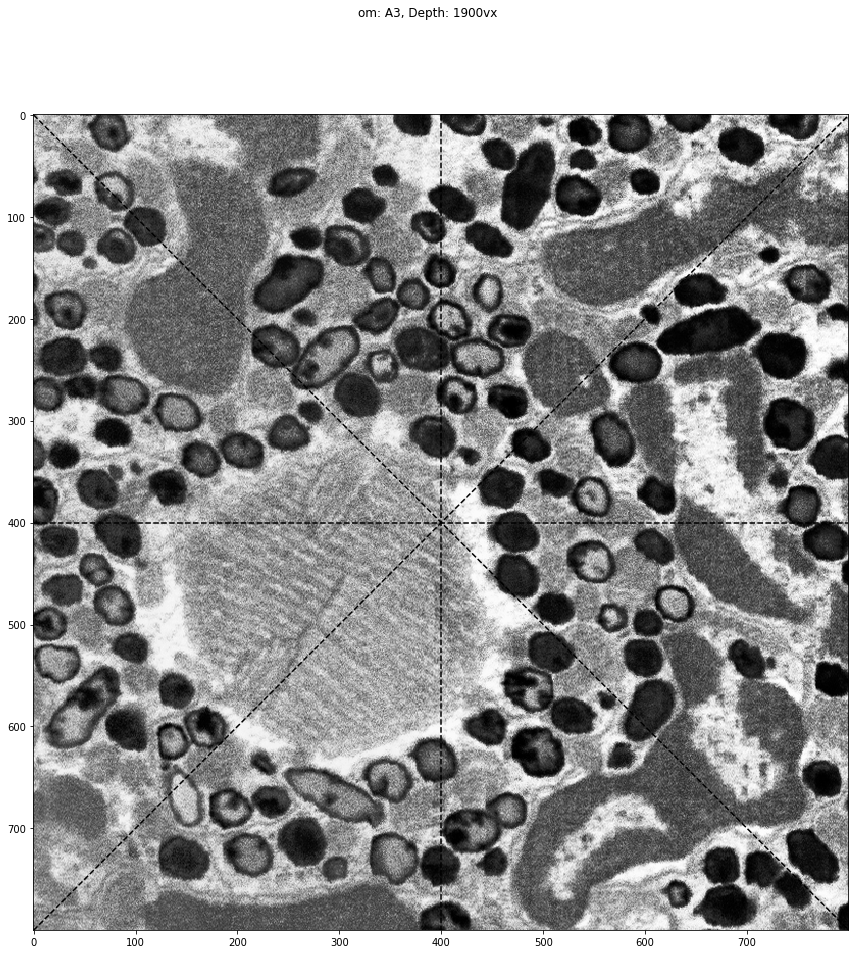

In [15]:
fig, ax = plt.subplots(1, figsize=[15, 15])
d = d-step

ax = plt.plot([0, vol.shape[0]], [0, vol.shape[0]], c='k', ls='--')
ax = plt.plot([0, vol.shape[0]], [vol.shape[0], 0], c='k', ls='--')
ax = plt.plot([vol.shape[0]/2, vol.shape[0]/2], [0, vol.shape[1]], c='k', ls='--')
ax = plt.plot([0, vol.shape[1]], [vol.shape[0]/2, vol.shape[0]/2], c='k', ls='--')

ax = plt.imshow(vol[:, :, d], cmap='gray', aspect='equal')

fig.suptitle(f"om: {om}, Depth: {d}vx")

Text(0.5,0.98,'om: A3, Depth: 1850vx')

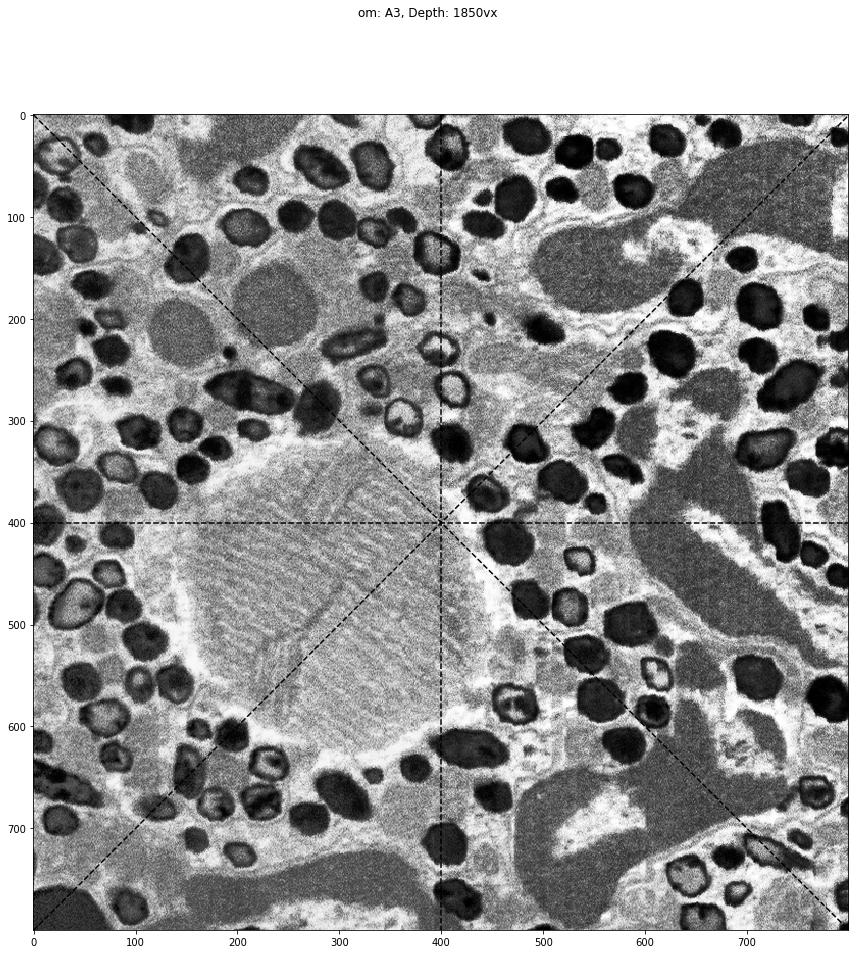

In [16]:
fig, ax = plt.subplots(1, figsize=[15, 15])
d = d-step

ax = plt.plot([0, vol.shape[0]], [0, vol.shape[0]], c='k', ls='--')
ax = plt.plot([0, vol.shape[0]], [vol.shape[0], 0], c='k', ls='--')
ax = plt.plot([vol.shape[0]/2, vol.shape[0]/2], [0, vol.shape[1]], c='k', ls='--')
ax = plt.plot([0, vol.shape[1]], [vol.shape[0]/2, vol.shape[0]/2], c='k', ls='--')

ax = plt.imshow(vol[:, :, d], cmap='gray', aspect='equal')

fig.suptitle(f"om: {om}, Depth: {d}vx")

Text(0.5,0.98,'om: A3, Depth: 1800vx')

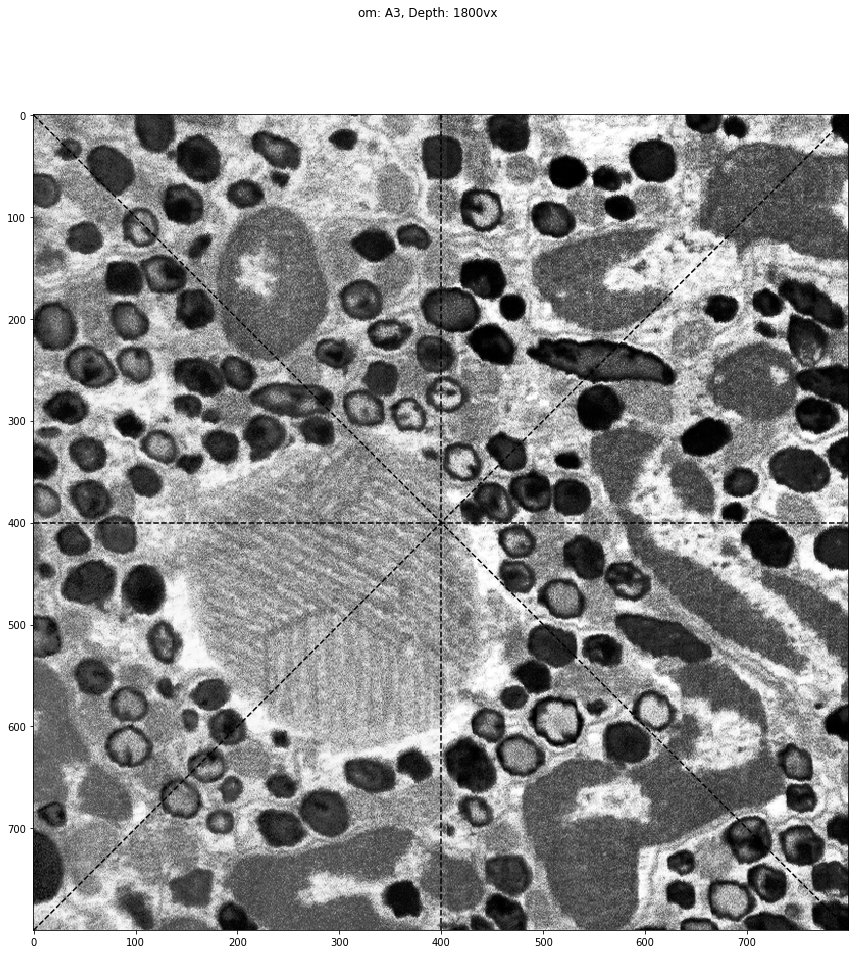

In [17]:
fig, ax = plt.subplots(1, figsize=[15, 15])
d = d-step

ax = plt.plot([0, vol.shape[0]], [0, vol.shape[0]], c='k', ls='--')
ax = plt.plot([0, vol.shape[0]], [vol.shape[0], 0], c='k', ls='--')
ax = plt.plot([vol.shape[0]/2, vol.shape[0]/2], [0, vol.shape[1]], c='k', ls='--')
ax = plt.plot([0, vol.shape[1]], [vol.shape[0]/2, vol.shape[0]/2], c='k', ls='--')

ax = plt.imshow(vol[:, :, d], cmap='gray', aspect='equal')

fig.suptitle(f"om: {om}, Depth: {d}vx")

Text(0.5,0.98,'om: A3, Depth: 1750vx')

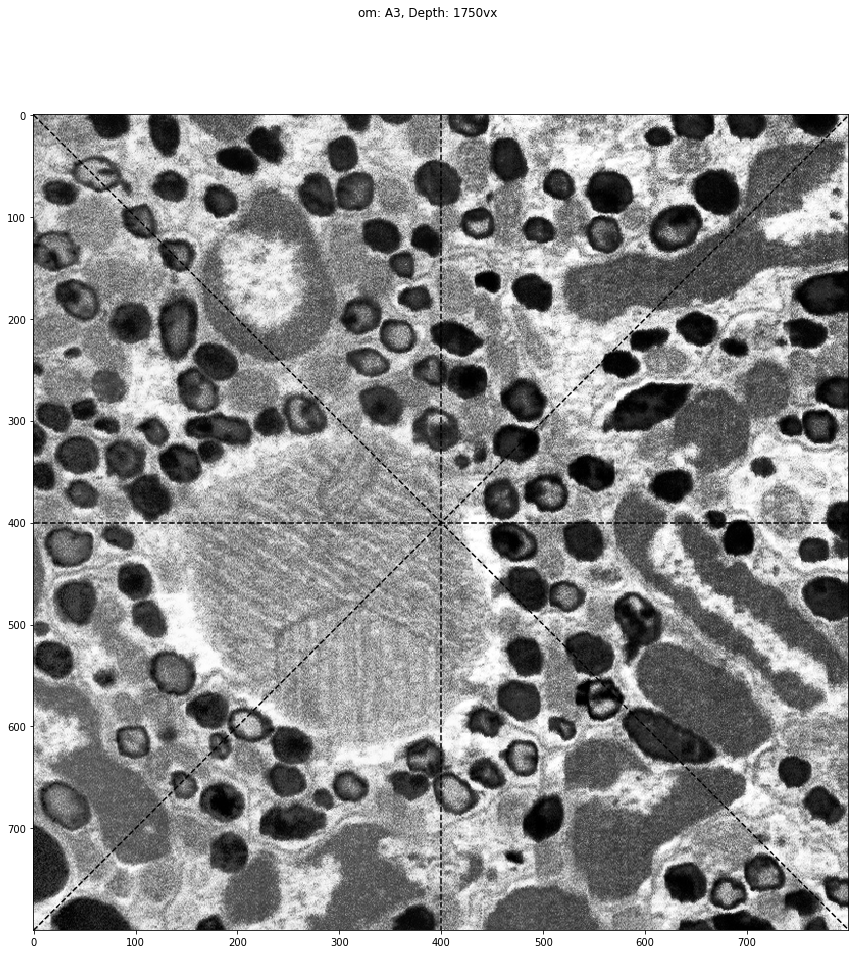

In [18]:
fig, ax = plt.subplots(1, figsize=[15, 15])
d = d-step

ax = plt.plot([0, vol.shape[0]], [0, vol.shape[0]], c='k', ls='--')
ax = plt.plot([0, vol.shape[0]], [vol.shape[0], 0], c='k', ls='--')
ax = plt.plot([vol.shape[0]/2, vol.shape[0]/2], [0, vol.shape[1]], c='k', ls='--')
ax = plt.plot([0, vol.shape[1]], [vol.shape[0]/2, vol.shape[0]/2], c='k', ls='--')

ax = plt.imshow(vol[:, :, d], cmap='gray', aspect='equal')

fig.suptitle(f"om: {om}, Depth: {d}vx")

Text(0.5,0.98,'om: A3, Depth: 1700vx')

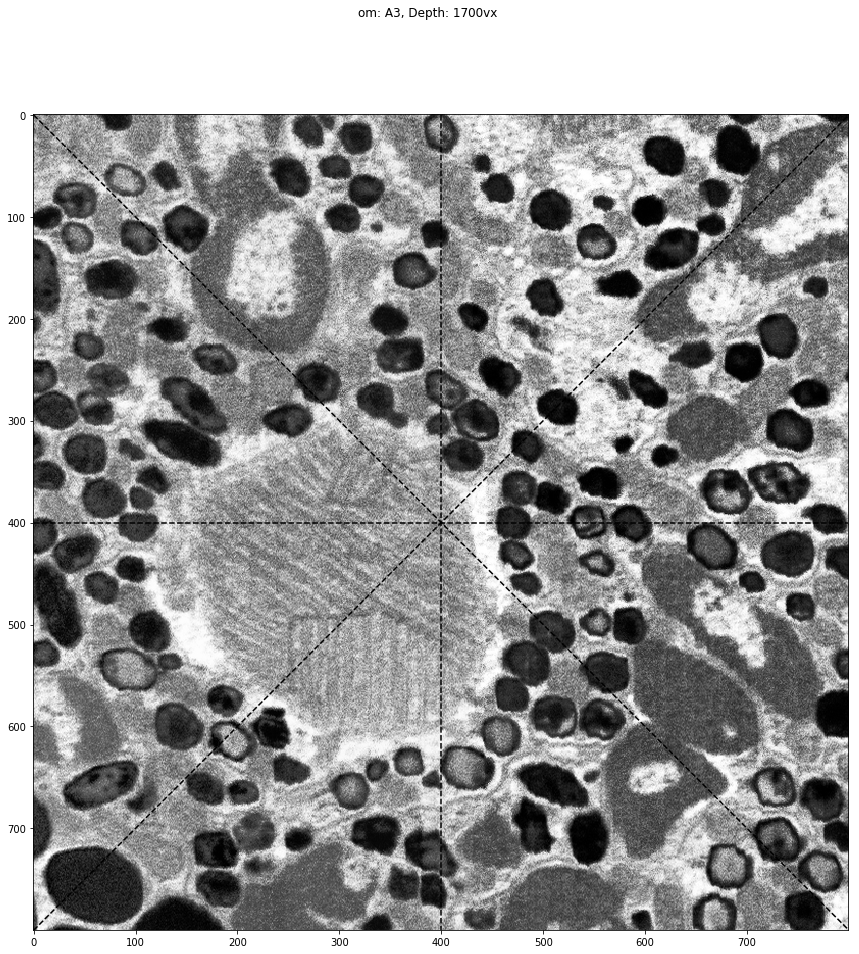

In [19]:
fig, ax = plt.subplots(1, figsize=[15, 15])
d = d-step

ax = plt.plot([0, vol.shape[0]], [0, vol.shape[0]], c='k', ls='--')
ax = plt.plot([0, vol.shape[0]], [vol.shape[0], 0], c='k', ls='--')
ax = plt.plot([vol.shape[0]/2, vol.shape[0]/2], [0, vol.shape[1]], c='k', ls='--')
ax = plt.plot([0, vol.shape[1]], [vol.shape[0]/2, vol.shape[0]/2], c='k', ls='--')

ax = plt.imshow(vol[:, :, d], cmap='gray', aspect='equal')

fig.suptitle(f"om: {om}, Depth: {d}vx")

Text(0.5,0.98,'om: A3, Depth: 1650vx')

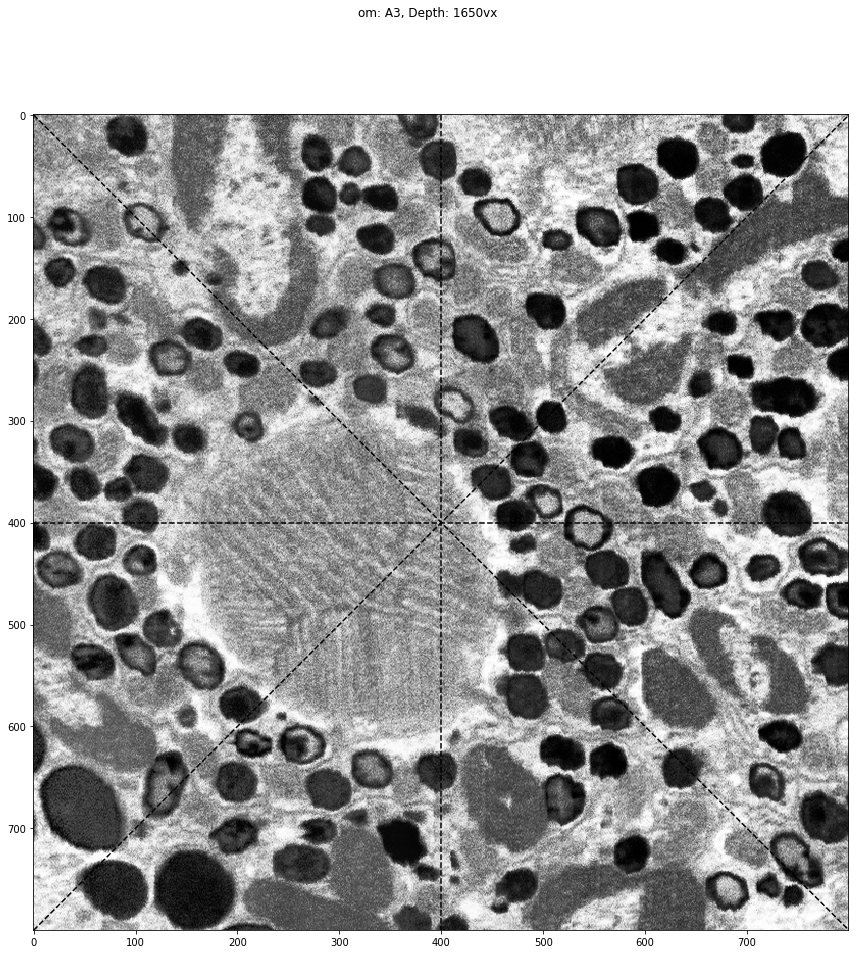

In [20]:
fig, ax = plt.subplots(1, figsize=[15, 15])
d = d-step

ax = plt.plot([0, vol.shape[0]], [0, vol.shape[0]], c='k', ls='--')
ax = plt.plot([0, vol.shape[0]], [vol.shape[0], 0], c='k', ls='--')
ax = plt.plot([vol.shape[0]/2, vol.shape[0]/2], [0, vol.shape[1]], c='k', ls='--')
ax = plt.plot([0, vol.shape[1]], [vol.shape[0]/2, vol.shape[0]/2], c='k', ls='--')

ax = plt.imshow(vol[:, :, d], cmap='gray', aspect='equal')

fig.suptitle(f"om: {om}, Depth: {d}vx")

Text(0.5,0.98,'om: A3, Depth: 1600vx')

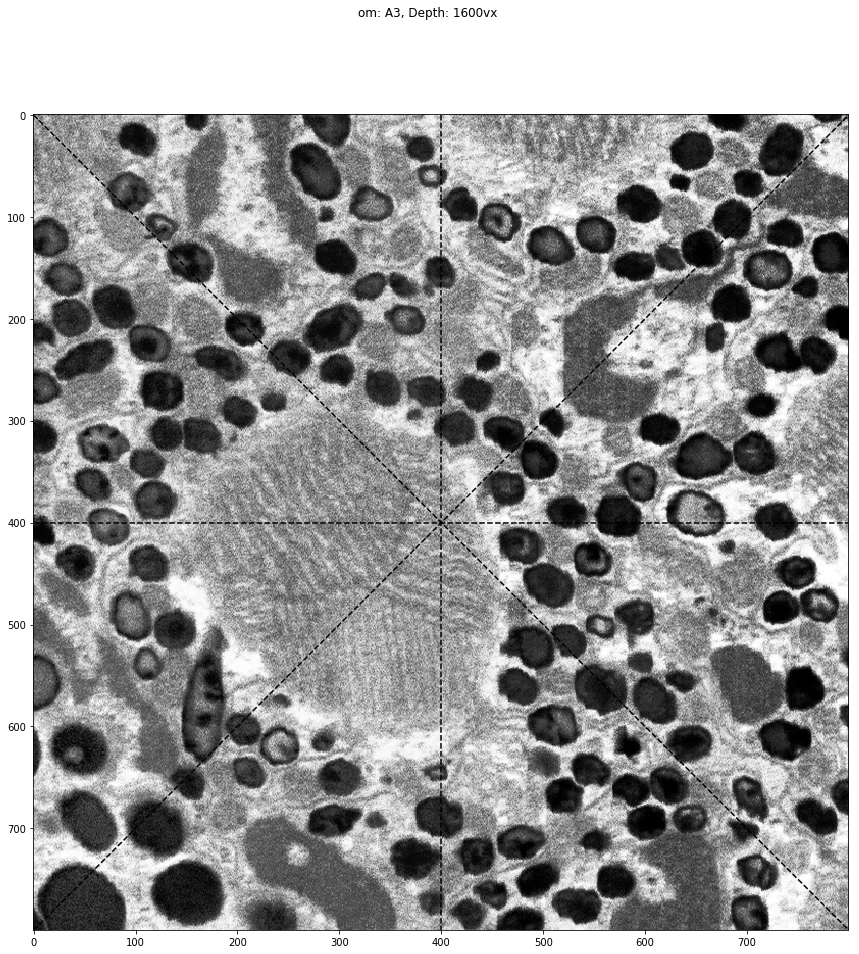

In [21]:
fig, ax = plt.subplots(1, figsize=[15, 15])
d = d-step

ax = plt.plot([0, vol.shape[0]], [0, vol.shape[0]], c='k', ls='--')
ax = plt.plot([0, vol.shape[0]], [vol.shape[0], 0], c='k', ls='--')
ax = plt.plot([vol.shape[0]/2, vol.shape[0]/2], [0, vol.shape[1]], c='k', ls='--')
ax = plt.plot([0, vol.shape[1]], [vol.shape[0]/2, vol.shape[0]/2], c='k', ls='--')

ax = plt.imshow(vol[:, :, d], cmap='gray', aspect='equal')

fig.suptitle(f"om: {om}, Depth: {d}vx")

Text(0.5,0.98,'om: C6, Depth: 1450vx')

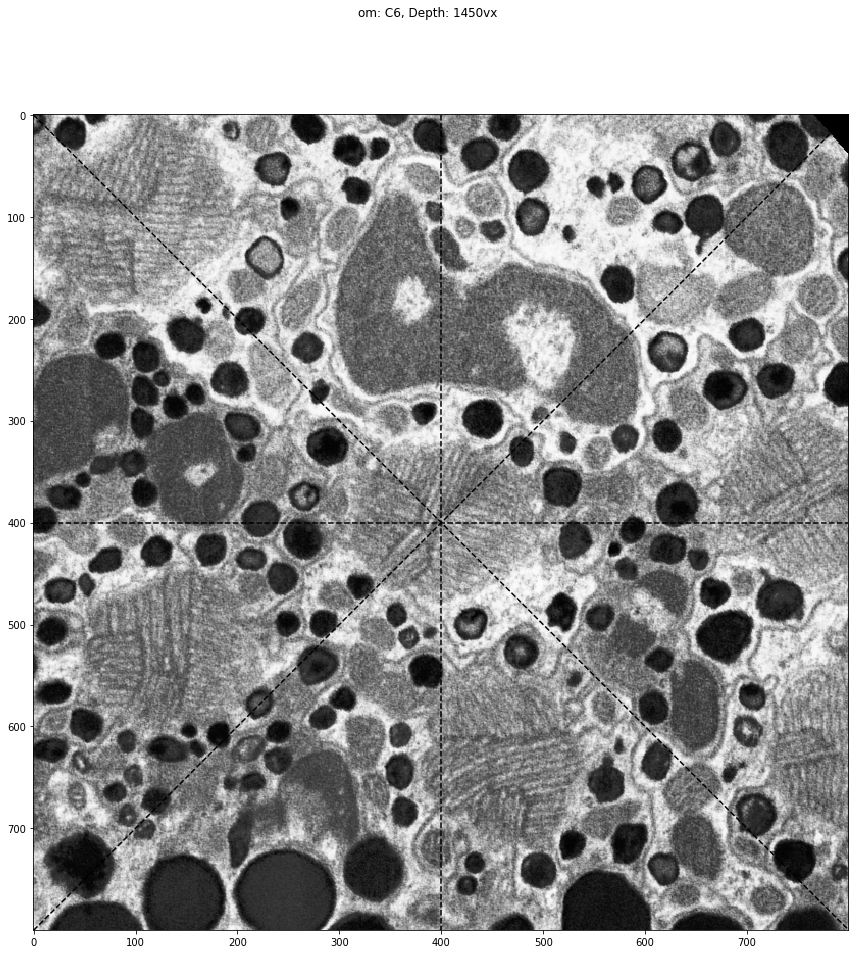

In [18]:
fig, ax = plt.subplots(1, figsize=[15, 15])
d = d-step

ax = plt.plot([0, vol.shape[0]], [0, vol.shape[0]], c='k', ls='--')
ax = plt.plot([0, vol.shape[0]], [vol.shape[0], 0], c='k', ls='--')
ax = plt.plot([vol.shape[0]/2, vol.shape[0]/2], [0, vol.shape[1]], c='k', ls='--')
ax = plt.plot([0, vol.shape[1]], [vol.shape[0]/2, vol.shape[0]/2], c='k', ls='--')

ax = plt.imshow(vol[:, :, d], cmap='gray', aspect='equal')

fig.suptitle(f"om: {om}, Depth: {d}vx")

Text(0.5,0.98,'om: C6, Depth: 1400vx')

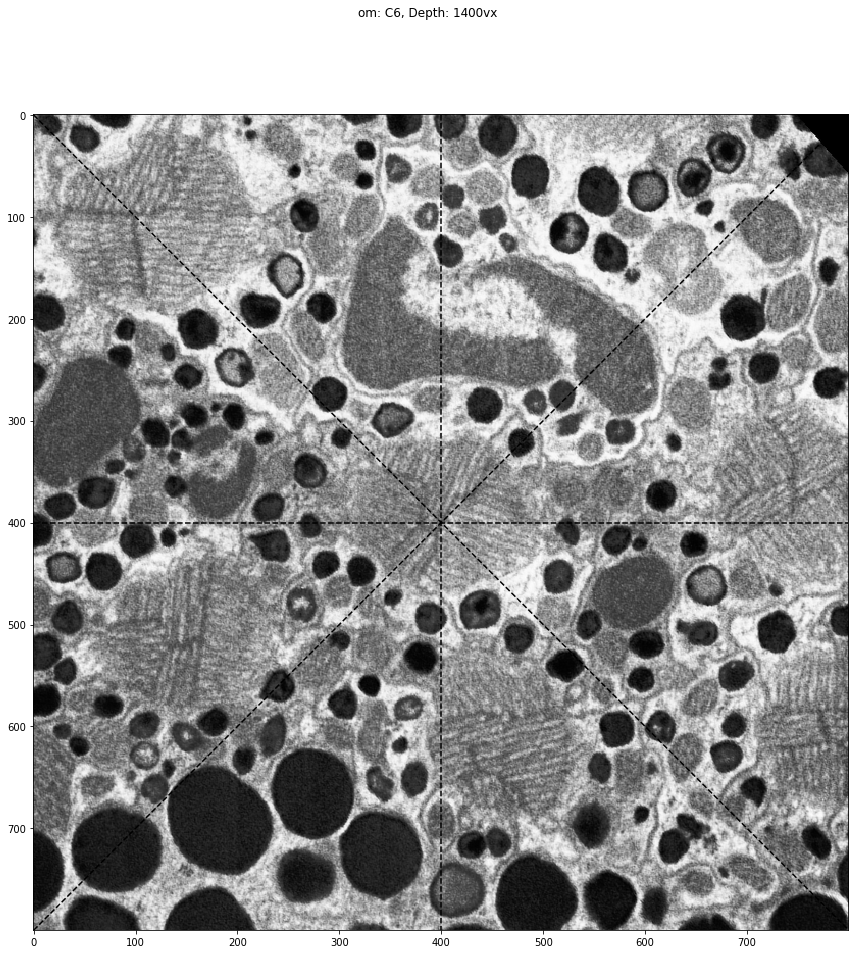

In [19]:
fig, ax = plt.subplots(1, figsize=[15, 15])
d = d-step

ax = plt.plot([0, vol.shape[0]], [0, vol.shape[0]], c='k', ls='--')
ax = plt.plot([0, vol.shape[0]], [vol.shape[0], 0], c='k', ls='--')
ax = plt.plot([vol.shape[0]/2, vol.shape[0]/2], [0, vol.shape[1]], c='k', ls='--')
ax = plt.plot([0, vol.shape[1]], [vol.shape[0]/2, vol.shape[0]/2], c='k', ls='--')

ax = plt.imshow(vol[:, :, d], cmap='gray', aspect='equal')

fig.suptitle(f"om: {om}, Depth: {d}vx")

Text(0.5,0.98,'om: C6, Depth: 1350vx')

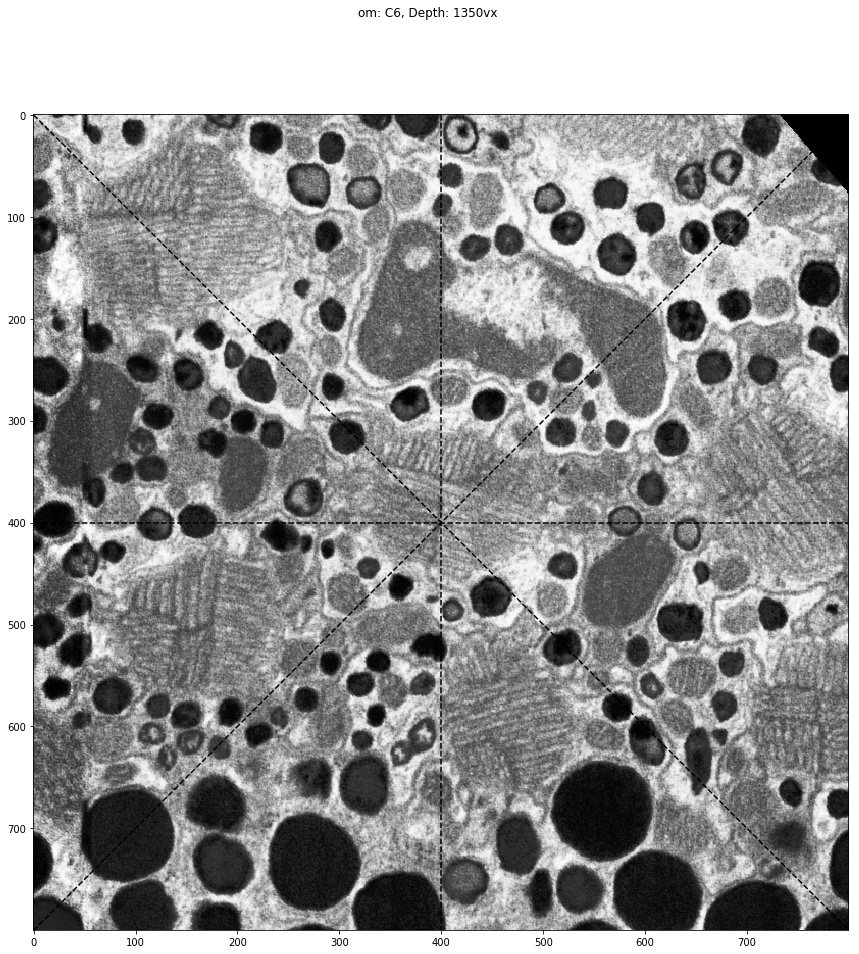

In [20]:
fig, ax = plt.subplots(1, figsize=[15, 15])
d = d-step

ax = plt.plot([0, vol.shape[0]], [0, vol.shape[0]], c='k', ls='--')
ax = plt.plot([0, vol.shape[0]], [vol.shape[0], 0], c='k', ls='--')
ax = plt.plot([vol.shape[0]/2, vol.shape[0]/2], [0, vol.shape[1]], c='k', ls='--')
ax = plt.plot([0, vol.shape[1]], [vol.shape[0]/2, vol.shape[0]/2], c='k', ls='--')

ax = plt.imshow(vol[:, :, d], cmap='gray', aspect='equal')

fig.suptitle(f"om: {om}, Depth: {d}vx")

Text(0.5,0.98,'om: C6, Depth: 1300vx')

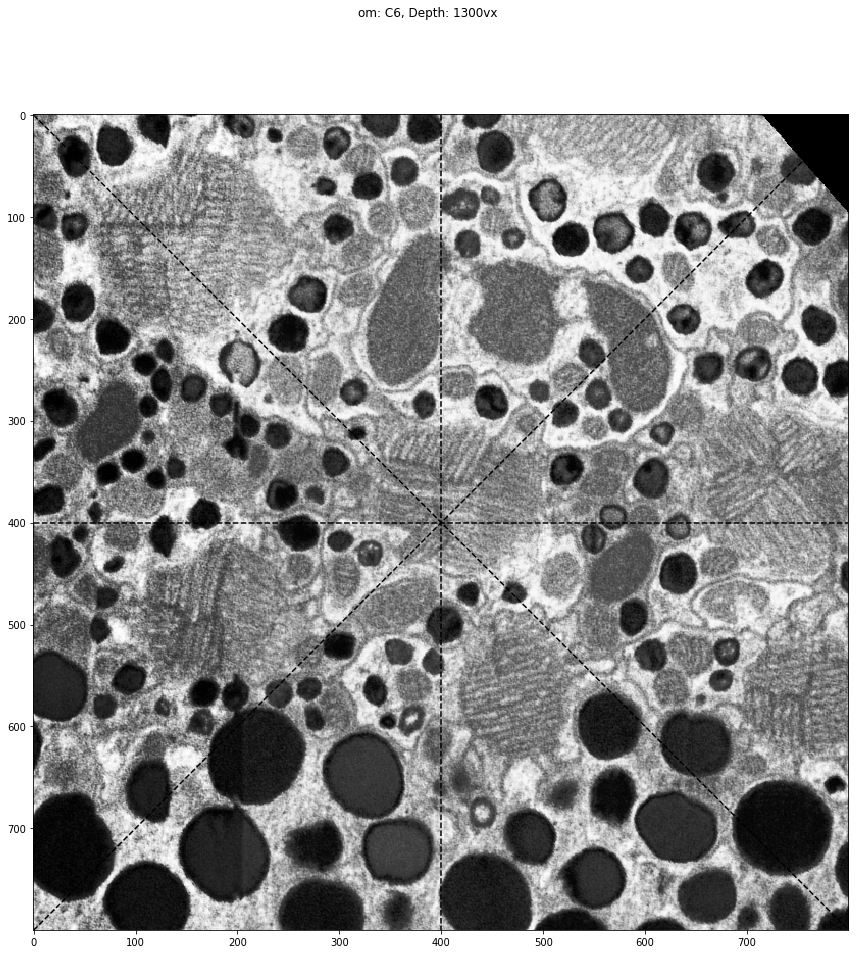

In [21]:
fig, ax = plt.subplots(1, figsize=[15, 15])
d = d-step

ax = plt.plot([0, vol.shape[0]], [0, vol.shape[0]], c='k', ls='--')
ax = plt.plot([0, vol.shape[0]], [vol.shape[0], 0], c='k', ls='--')
ax = plt.plot([vol.shape[0]/2, vol.shape[0]/2], [0, vol.shape[1]], c='k', ls='--')
ax = plt.plot([0, vol.shape[1]], [vol.shape[0]/2, vol.shape[0]/2], c='k', ls='--')

ax = plt.imshow(vol[:, :, d], cmap='gray', aspect='equal')

fig.suptitle(f"om: {om}, Depth: {d}vx")

Text(0.5,0.98,'om: C6, Depth: 1250vx')

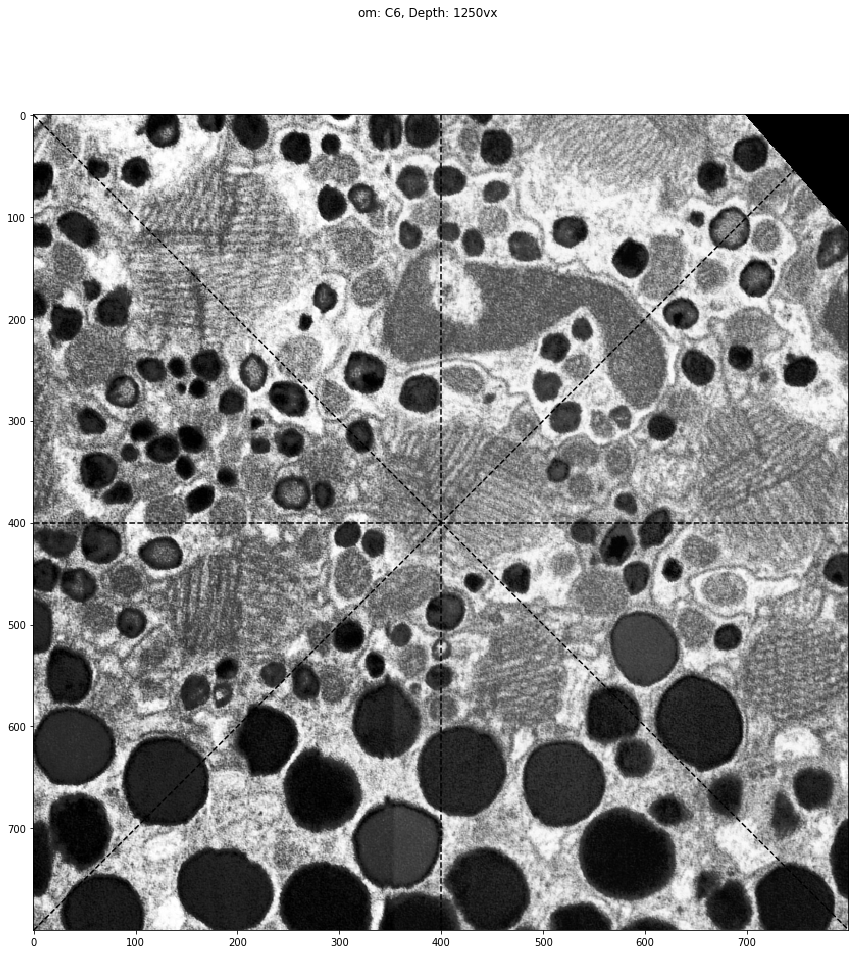

In [22]:
fig, ax = plt.subplots(1, figsize=[15, 15])
d = d-step

ax = plt.plot([0, vol.shape[0]], [0, vol.shape[0]], c='k', ls='--')
ax = plt.plot([0, vol.shape[0]], [vol.shape[0], 0], c='k', ls='--')
ax = plt.plot([vol.shape[0]/2, vol.shape[0]/2], [0, vol.shape[1]], c='k', ls='--')
ax = plt.plot([0, vol.shape[1]], [vol.shape[0]/2, vol.shape[0]/2], c='k', ls='--')

ax = plt.imshow(vol[:, :, d], cmap='gray', aspect='equal')

fig.suptitle(f"om: {om}, Depth: {d}vx")

Text(0.5,0.98,'om: C6, Depth: 1200vx')

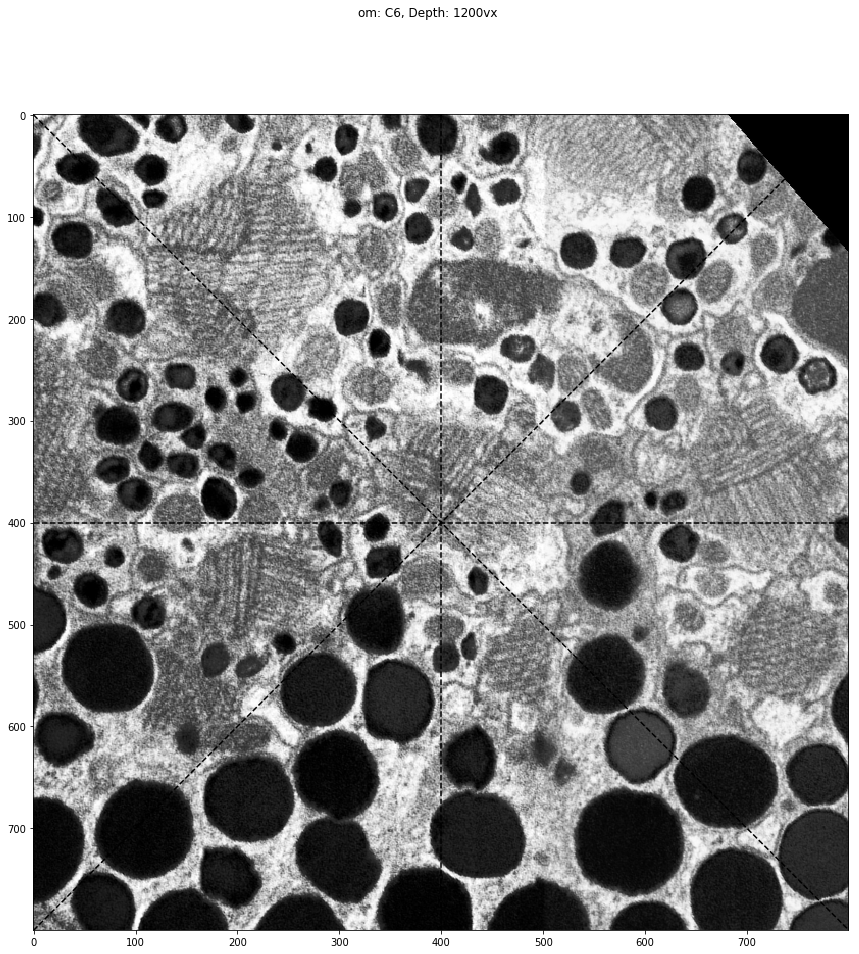

In [23]:
fig, ax = plt.subplots(1, figsize=[15, 15])
d = d-step

ax = plt.plot([0, vol.shape[0]], [0, vol.shape[0]], c='k', ls='--')
ax = plt.plot([0, vol.shape[0]], [vol.shape[0], 0], c='k', ls='--')
ax = plt.plot([vol.shape[0]/2, vol.shape[0]/2], [0, vol.shape[1]], c='k', ls='--')
ax = plt.plot([0, vol.shape[1]], [vol.shape[0]/2, vol.shape[0]/2], c='k', ls='--')

ax = plt.imshow(vol[:, :, d], cmap='gray', aspect='equal')

fig.suptitle(f"om: {om}, Depth: {d}vx")

Text(0.5,0.98,'om: C6, Depth: 1150vx')

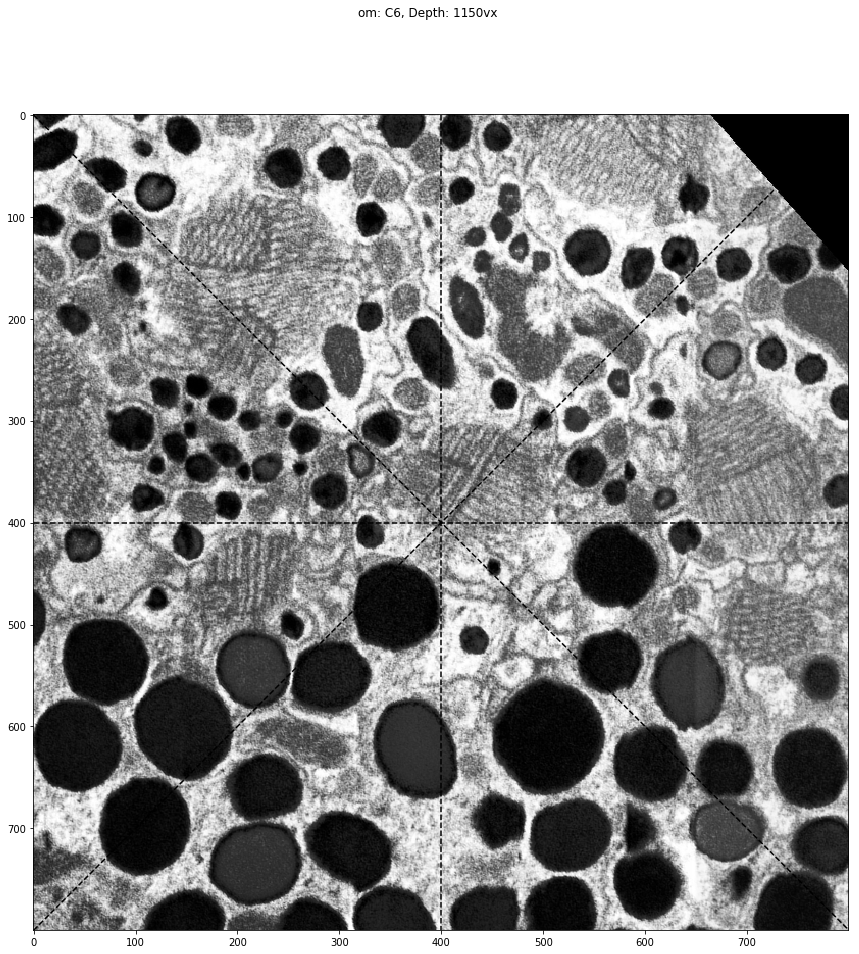

In [24]:
fig, ax = plt.subplots(1, figsize=[15, 15])
d = d-step

ax = plt.plot([0, vol.shape[0]], [0, vol.shape[0]], c='k', ls='--')
ax = plt.plot([0, vol.shape[0]], [vol.shape[0], 0], c='k', ls='--')
ax = plt.plot([vol.shape[0]/2, vol.shape[0]/2], [0, vol.shape[1]], c='k', ls='--')
ax = plt.plot([0, vol.shape[1]], [vol.shape[0]/2, vol.shape[0]/2], c='k', ls='--')

ax = plt.imshow(vol[:, :, d], cmap='gray', aspect='equal')

fig.suptitle(f"om: {om}, Depth: {d}vx")

Text(0.5,0.98,'om: C6, Depth: 1100vx')

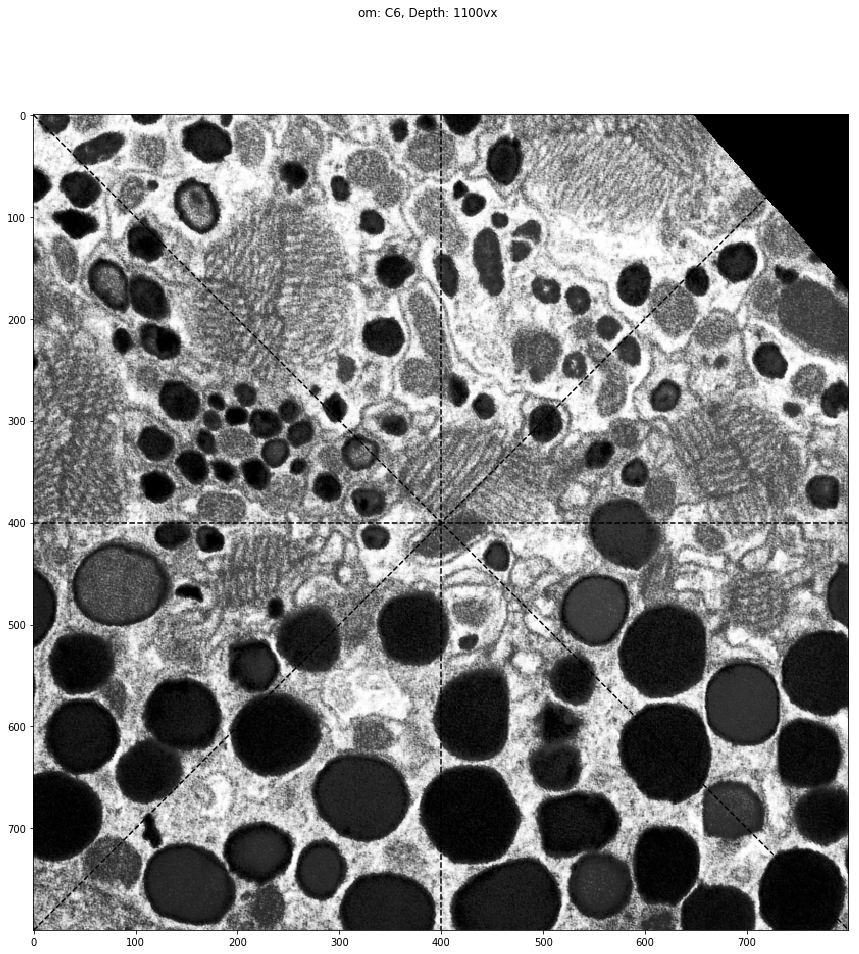

In [25]:
fig, ax = plt.subplots(1, figsize=[15, 15])
d = d-step

ax = plt.plot([0, vol.shape[0]], [0, vol.shape[0]], c='k', ls='--')
ax = plt.plot([0, vol.shape[0]], [vol.shape[0], 0], c='k', ls='--')
ax = plt.plot([vol.shape[0]/2, vol.shape[0]/2], [0, vol.shape[1]], c='k', ls='--')
ax = plt.plot([0, vol.shape[1]], [vol.shape[0]/2, vol.shape[0]/2], c='k', ls='--')

ax = plt.imshow(vol[:, :, d], cmap='gray', aspect='equal')

fig.suptitle(f"om: {om}, Depth: {d}vx")

Text(0.5,0.98,'om: C6, Depth: 1050vx')

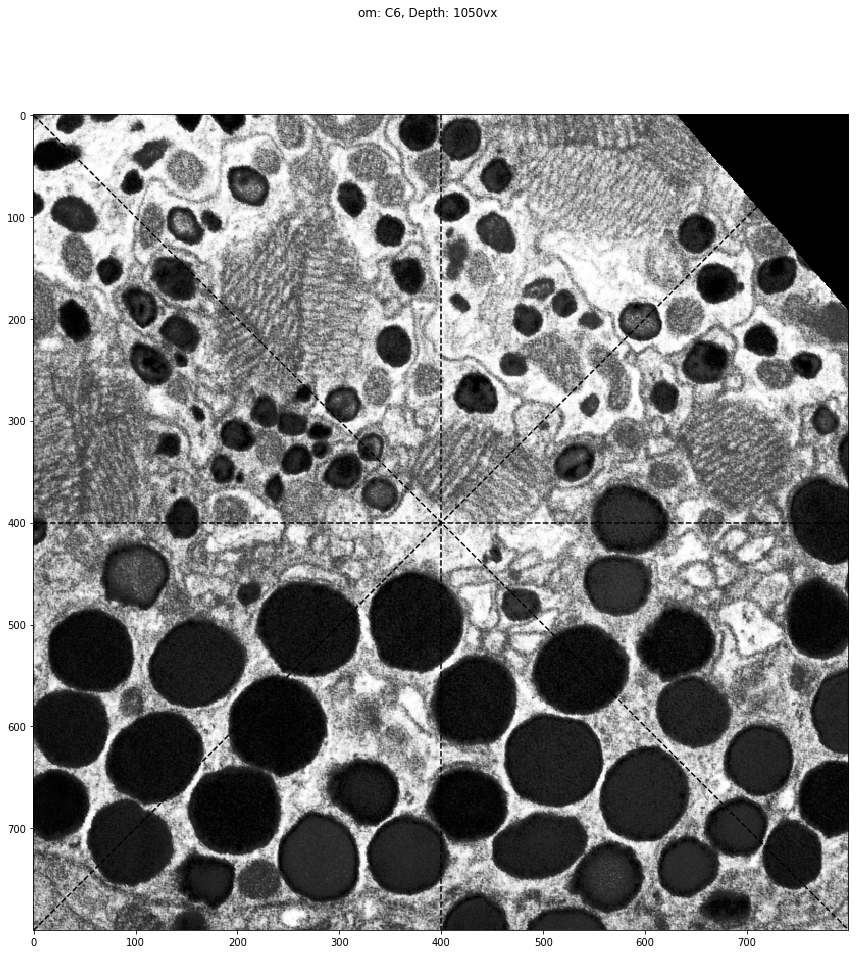

In [26]:
fig, ax = plt.subplots(1, figsize=[15, 15])
d = d-step

ax = plt.plot([0, vol.shape[0]], [0, vol.shape[0]], c='k', ls='--')
ax = plt.plot([0, vol.shape[0]], [vol.shape[0], 0], c='k', ls='--')
ax = plt.plot([vol.shape[0]/2, vol.shape[0]/2], [0, vol.shape[1]], c='k', ls='--')
ax = plt.plot([0, vol.shape[1]], [vol.shape[0]/2, vol.shape[0]/2], c='k', ls='--')

ax = plt.imshow(vol[:, :, d], cmap='gray', aspect='equal')

fig.suptitle(f"om: {om}, Depth: {d}vx")

Text(0.5,0.98,'om: C6, Depth: 1000vx')

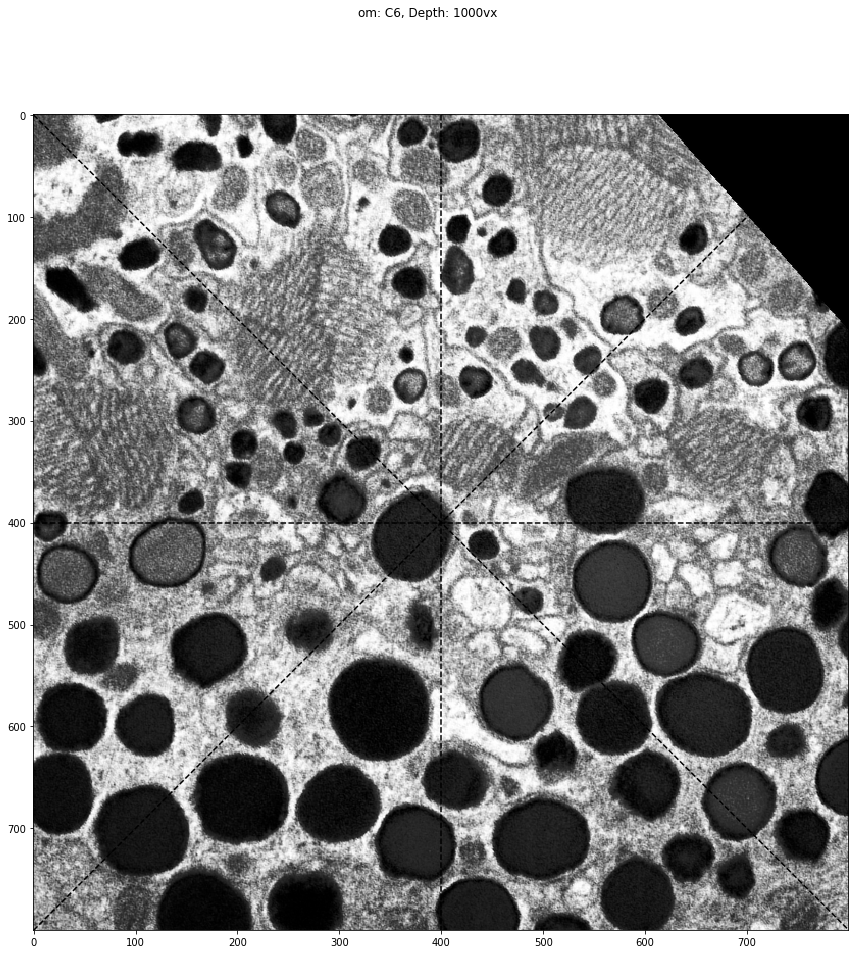

In [27]:
fig, ax = plt.subplots(1, figsize=[15, 15])
d = d-step

ax = plt.plot([0, vol.shape[0]], [0, vol.shape[0]], c='k', ls='--')
ax = plt.plot([0, vol.shape[0]], [vol.shape[0], 0], c='k', ls='--')
ax = plt.plot([vol.shape[0]/2, vol.shape[0]/2], [0, vol.shape[1]], c='k', ls='--')
ax = plt.plot([0, vol.shape[1]], [vol.shape[0]/2, vol.shape[0]/2], c='k', ls='--')

ax = plt.imshow(vol[:, :, d], cmap='gray', aspect='equal')

fig.suptitle(f"om: {om}, Depth: {d}vx")

Text(0.5,0.98,'om: C6, Depth: 950vx')

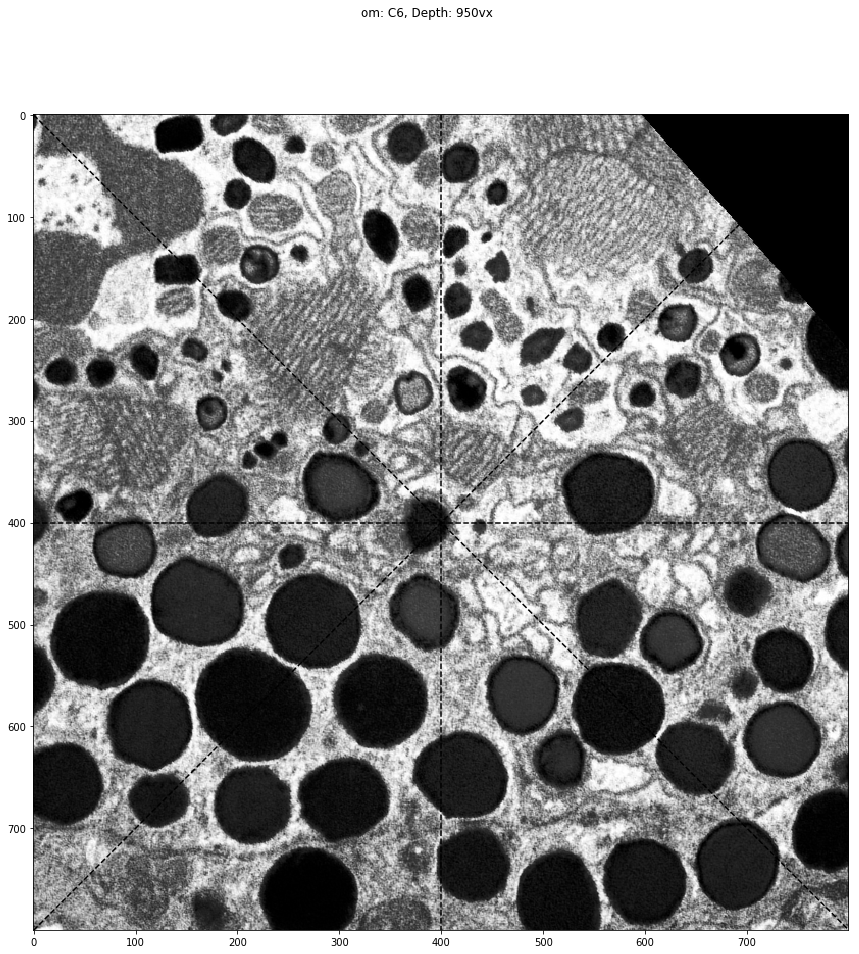

In [28]:
fig, ax = plt.subplots(1, figsize=[15, 15])
d = d-step

ax = plt.plot([0, vol.shape[0]], [0, vol.shape[0]], c='k', ls='--')
ax = plt.plot([0, vol.shape[0]], [vol.shape[0], 0], c='k', ls='--')
ax = plt.plot([vol.shape[0]/2, vol.shape[0]/2], [0, vol.shape[1]], c='k', ls='--')
ax = plt.plot([0, vol.shape[1]], [vol.shape[0]/2, vol.shape[0]/2], c='k', ls='--')

ax = plt.imshow(vol[:, :, d], cmap='gray', aspect='equal')

fig.suptitle(f"om: {om}, Depth: {d}vx")

Text(0.5,0.98,'om: C6, Depth: 900vx')

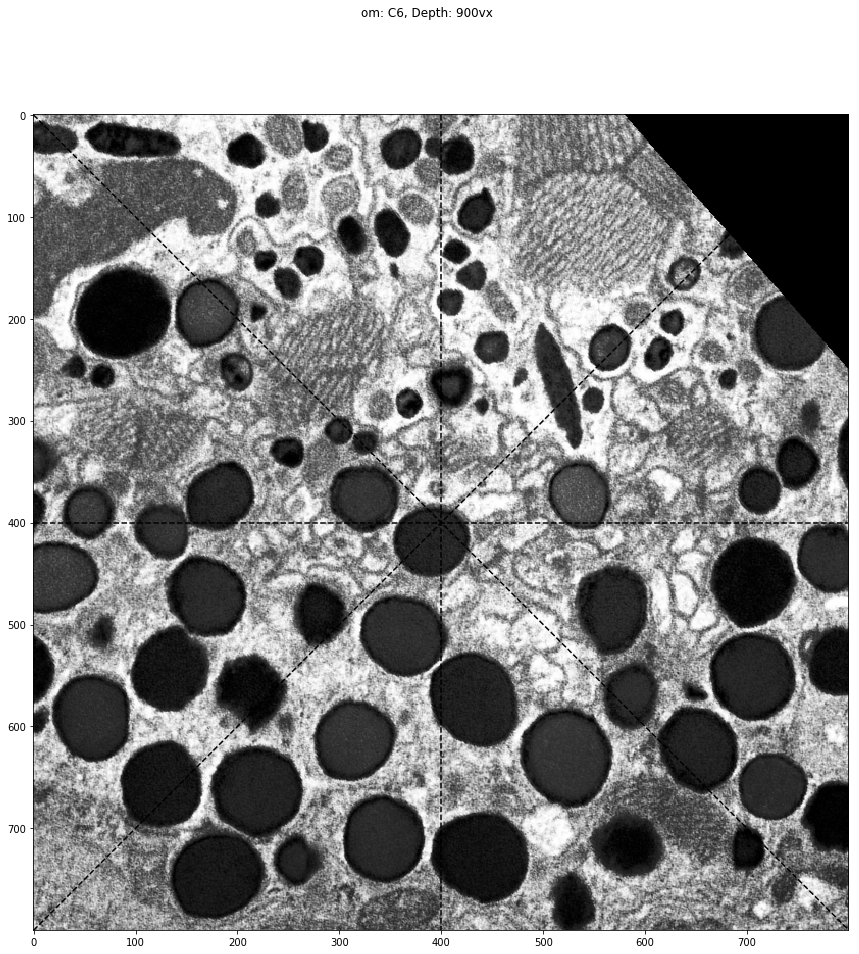

In [29]:
fig, ax = plt.subplots(1, figsize=[15, 15])
d = d-step

ax = plt.plot([0, vol.shape[0]], [0, vol.shape[0]], c='k', ls='--')
ax = plt.plot([0, vol.shape[0]], [vol.shape[0], 0], c='k', ls='--')
ax = plt.plot([vol.shape[0]/2, vol.shape[0]/2], [0, vol.shape[1]], c='k', ls='--')
ax = plt.plot([0, vol.shape[1]], [vol.shape[0]/2, vol.shape[0]/2], c='k', ls='--')

ax = plt.imshow(vol[:, :, d], cmap='gray', aspect='equal')

fig.suptitle(f"om: {om}, Depth: {d}vx")